In [2]:
import pandas as pd
import sys
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns

from scipy.stats import pearsonr
from math import sqrt
import statistics 

In [2]:
monitoring_whole_data = pd.read_csv("US_data/BigUS/us_monitoring.csv")
monitoring_whole_data

,year,day,cmaq_x,cmaq_y,elev,emissi11_pm25,forest_cover,high,limi,local,...,narr_vgrd1815mb,narr_tmp30m,narr_pres2m,narr_pres10m,narr_pres30m,aod_value,pm25_value,gc_aod,pm25_value_k,month
0,2011,1,-2.256897e+05,3.587932e+05,35.77930,0.0,0.000000,0.000000,0.000000,873.759842,...,0.498815,294.425,101386.0,101282.0,101040.0,0.112333,8.6,0.021297,8.582339,1.0
1,2011,1,1.571739e+06,3.949590e+05,1.01104,0.0,0.000000,1050.015418,0.000000,807.793896,...,2.506630,298.217,101552.0,101482.0,101273.0,NaN,7.9,0.107923,7.383566,1.0
2,2011,1,-1.291484e+05,4.863733e+05,2.43082,0.0,0.000000,0.000000,0.000000,1009.915135,...,0.496211,293.508,101352.0,101282.0,101073.0,0.027000,5.9,0.022637,5.900033,1.0
3,2011,1,1.430635e+06,4.666680e+05,3.87558,0.0,0.000000,0.000000,2030.156665,0.000000,...,3.678500,295.279,97185.8,97082.1,96839.6,NaN,5.4,0.111803,7.488950,1.0
4,2011,1,1.573342e+06,4.646160e+05,3.35600,0.0,0.020202,0.000000,0.000000,2037.573293,...,3.912880,296.529,101586.0,101515.0,101273.0,NaN,10.2,0.100897,7.398404,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249124,2011,365,-1.900296e+06,3.057078e+06,595.92000,0.0,0.970588,0.000000,0.000000,0.000000,...,3.819380,290.432,100123.0,99985.6,99776.6,NaN,4.7,0.016803,10.765756,12.0
249125,2011,365,-1.791970e+06,3.056591e+06,758.28300,0.0,0.778547,0.000000,0.000000,0.000000,...,-0.599889,288.057,96756.0,96652.2,96410.0,NaN,9.9,0.007157,9.456686,12.0
249126,2011,365,-1.948693e+06,3.092715e+06,3.58333,0.0,0.004456,0.000000,0.000000,0.000000,...,1.504280,288.724,102023.0,101886.0,101677.0,NaN,3.9,0.032277,11.428495,12.0
249127,2011,365,-2.117447e+06,3.128790e+06,3.56685,0.0,0.100092,0.000000,0.000000,0.000000,...,1.819380,290.349,102189.0,102019.0,101843.0,NaN,2.7,0.018143,12.663332,12.0


In [3]:
tag_names = ['day', 'month', 'cmaq_x', 'cmaq_y', 'cmaq_id', 'rid', 'elev', 'forest_cover', 'pd', 'local', 'limi', 'high', 'is',
    'nldas_pevapsfc','nldas_pressfc', 'nldas_cape', 'nldas_ugrd10m', 'nldas_vgrd10m', 'nldas_tmp2m', 'nldas_rh2m', 'nldas_dlwrfsfc',
    'nldas_dswrfsfc', 'nldas_pcpsfc', 'nldas_fpcsfc', 'gc_aod', 'aod_value', 'emissi11_pm25', 'pm25_value']

In [4]:
monitoring_data = pd.read_csv("US_data/BigUS/us_monitoring.csv")[tag_names]
monitoring_data.shape

(249129, 28)

In [ ]:
#################### monitors in cal-nevada region ##############################

In [6]:
cal_mn_df = monitoring_data[monitoring_data['rid'] == 6]
monitors_cal = cal_mn_df['cmaq_id'].unique()
len(monitors_cal)

128

In [ ]:
#################### monitors in the entire US ##############################

In [ ]:
da_samples = []

for day_val in range(1,366):
    samples = len(monitoring_data[monitoring_data['day'] == day_val])
    da_samples.append(samples)    

In [ ]:
#################### correlation analysis ##############################

In [357]:
source_cmaq = np.load("/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/source_cmaq.npy").tolist()
source_df = monitoring_data[monitoring_whole_data['cmaq_id'].isin(source_cmaq)]
source_df = source_df.reset_index()

eastern_source_df = monitoring_data[monitoring_whole_data['cmaq_x'] > 0.0]
eastern_source_df = eastern_source_df.reset_index()

cmaq_ids = np.load(f"/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/tl-cal-10/split-5/target_cmaq.npz")

target_cmaq = cmaq_ids["train"].tolist()
target_df = monitoring_data[monitoring_whole_data['cmaq_id'].isin(target_cmaq)]
target_df = target_df.reset_index()


test_cmaq = cmaq_ids["test"].tolist()
test_df = monitoring_data[monitoring_whole_data['cmaq_id'].isin(test_cmaq)]
test_df = test_df.reset_index()

train_cmaq = target_cmaq + test_cmaq
train_df = monitoring_data[monitoring_whole_data['cmaq_id'].isin(train_cmaq)]
train_df = train_df.reset_index()

In [376]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
ss = MinMaxScaler()

monitoring_data[tag_names] =  ss.fit_transform(monitoring_data[tag_names])
source_df[tag_names] = ss.fit_transform(source_df[tag_names])
eastern_source_df[tag_names] = ss.fit_transform(eastern_source_df[tag_names])
target_df[tag_names] = ss.fit_transform(target_df[tag_names])
test_df[tag_names] = ss.fit_transform(test_df[tag_names])
train_df[tag_names] = ss.fit_transform(train_df[tag_names])

In [11]:
corr = monitoring_data.corr()

fig, axs = plt.subplots(figsize = (10, 10))
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_yticklabels(
    ax.get_yticklabels(),
    fontsize = 12
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    fontsize = 12,
    rotation=45,
    horizontalalignment='right'
);

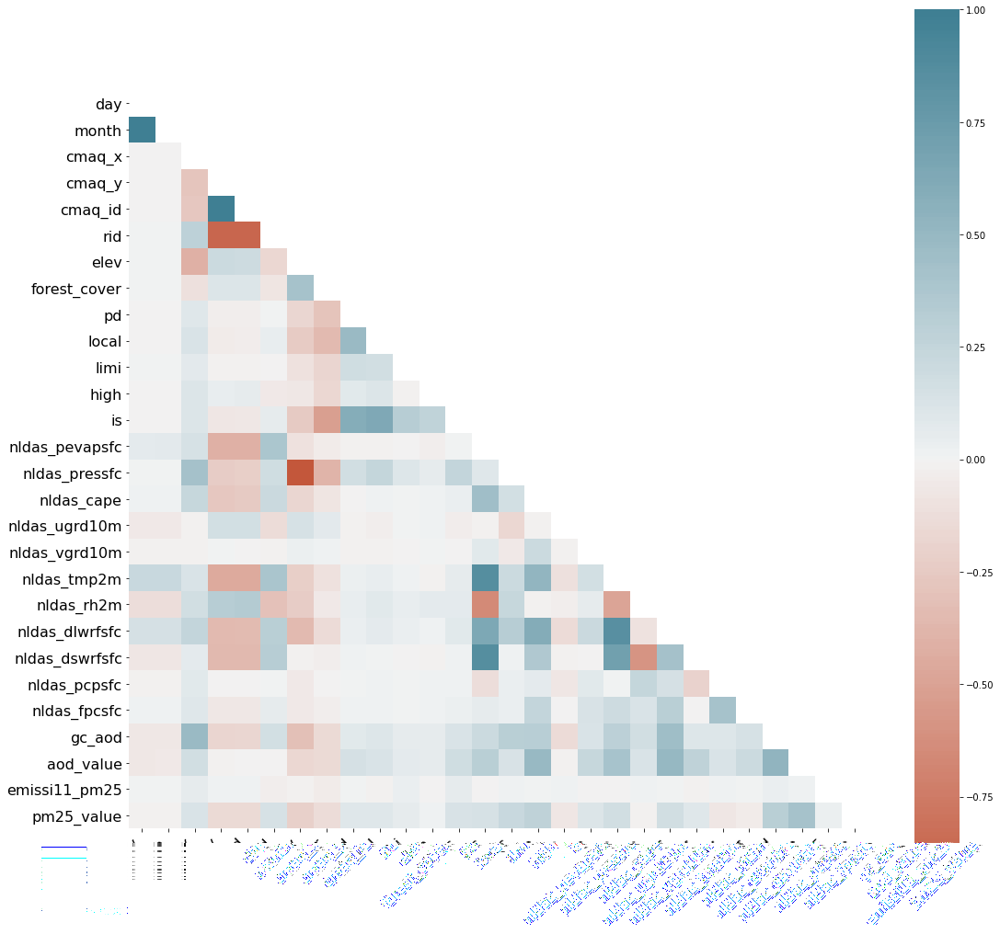

In [12]:
corr_matrix = monitoring_data.corr()

# create a mask for the upper triangle of the correlation matrix
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# plot the heatmap with only the lower triangle of the correlation matrix
fig, axs = plt.subplots(figsize=(18, 18))
ax = sns.heatmap(
    corr_matrix, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    mask=mask
)

ax.set_yticklabels(
    ax.get_yticklabels(),
    fontsize = 16
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    fontsize = 16,
    rotation=45,
    horizontalalignment='right'
);
plt.show()

In [ ]:
#################### Density plot ##############################

/Users/shrey/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/shrey/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/shrey/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or

Text(0.5, 1.0, 'Target Dataset')

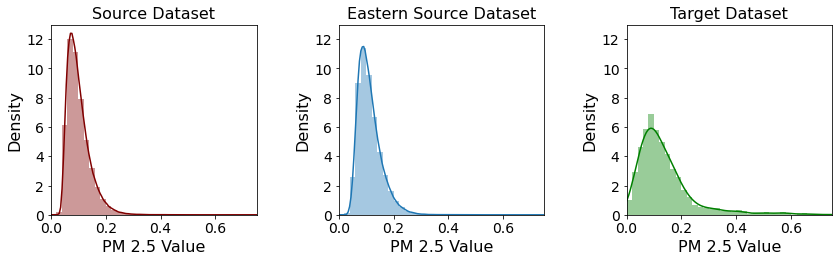

In [381]:
fig = plt.figure(figsize = (14, 3.5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

ax = fig.add_subplot(1, 3, 1)
sns.distplot(source_df.pm25_value, ax=ax, color='maroon').set(title ='Source Dataset')

plt.xlim(0, 0.75)
plt.ylim(0, 13)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("PM 2.5 Value", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.title("Source Dataset", fontsize=16)


ax = fig.add_subplot(1, 3, 2)
sns.distplot(eastern_source_df.pm25_value, ax=ax).set(title = 'Eastern Source Dataset')

plt.xlim(0, 0.75)
plt.ylim(0, 13)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("PM 2.5 Value", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.title("Eastern Source Dataset", fontsize=16)


ax = fig.add_subplot(1, 3, 3)
sns.distplot(target_df.pm25_value, ax=ax, color='green').set(title ='Target Dataset')

plt.xlim(0, 0.75)
plt.ylim(0, 13)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.xlabel("PM 2.5 Value", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.title("Target Dataset", fontsize=16)


# ax = fig.add_subplot(2, 2, 4)
# sns.distplot(test_df.pm25_value, ax=ax, color='grey').set(title ='Test Dataset')

In [ ]:
#################### Outlier Analysis ##############################

In [14]:
ax = monitoring_data[['elev', 'limi', 'local', 'high', 'nldas_pressfc', 'nldas_cape', 'nldas_pcpsfc', 'nldas_fpcsfc',
                      'gc_aod', 'aod_value', 'pm25_value']].plot(kind='box', fontsize = 12, rot = 45, figsize = (10, 4))
plt.show()

In [ ]:
#################### Variance Inflation Factor ##############################

In [17]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = monitoring_data.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(monitoring_data.values, i)
                          for i in range(len(monitoring_data.columns))]

In [19]:
####################################### Example for testing #######################################

df = pd.DataFrame({'Time': ['D=0', 'D=2', 'D=5', 'D=X'],
                   'Latency': [74.92, 75.32, 79.64, 100],
                   'Delay': [18.2, 80, 82, 84]})
latency_min_max = np.array([(73.3, 76), (73.3, 80), (75, 83.3), (100, 100)]).T
latency_err = np.abs(latency_min_max - df['Latency'].to_numpy())
delay_min_max = np.array([(0, 50), (50, 100), (68, 90), (75, 90)]).T
delay_err = np.abs(delay_min_max - df['Delay'].to_numpy())

plt.errorbar('Time', 'Latency', yerr=latency_err, data=df, marker='s', capsize=2,
             color='black', markersize=4, linewidth=1, linestyle='--')
plt.errorbar('Time', 'Delay', yerr=delay_err, data=df,
             marker='o', capsize=4, color='black', markersize=4, linewidth=1, linestyle='-')

plt.fill_between(df['Time'], latency_min_max[0, :], latency_min_max[1, :], color='red', alpha=0.2, label='Latency error')
plt.fill_between(df['Time'], delay_min_max[0, :], delay_min_max[1, :], color='blue', alpha=0.2, label='Delay error')

plt.legend()
plt.xlabel("Time")
plt.ylabel("Average Score (%)")
plt.ylim(0, 100)
plt.xlim(-0.2, 3.2)
plt.show()

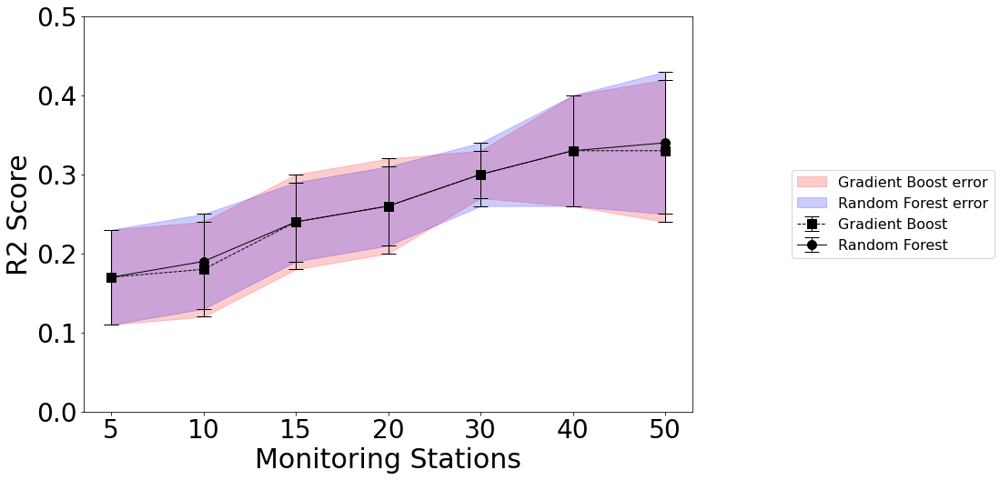

In [67]:
####################################### R2 score ==> No transfer learning #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                   'Gradient Boost': [0.17, 0.18, 0.24, 0.26, 0.30, 0.33, 0.33],
                   'Random Forest': [0.17, 0.19, 0.24, 0.26, 0.30, 0.33, 0.34], 
                   'AdaBoost': [0.12, 0.09, 0.10, 0.10, 0.15, 0.18, 0.18],
                   'Support Vector Regression': [0.07, 0.05, 0.06, 0.07, 0.10, 0.11, 0.11],
                   'Stochastic Gradient Descent': [0.06, 0.08, 0.09, 0.10, 0.10, 0.11, 0.12]})

gbr_err = np.array([0.06, 0.06, 0.06, 0.06, 0.03, 0.07, 0.09])
rf_err = np.array([0.06, 0.06, 0.05, 0.05, 0.04, 0.07, 0.09])
adaboost_err = np.array([0.06, 0.04, 0.03, 0.05, 0.05, 0.06, 0.05, ])
svr_err = np.array([0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.05])
sgd_err = np.array([0.05, 0.04, 0.03, 0.03, 0.04, 0.02, 0.02])

gbr_err_min = np.abs(df_no_tf_r2['Gradient Boost'].to_numpy() - gbr_err)
gbr_err_max = np.abs(df_no_tf_r2['Gradient Boost'].to_numpy() + gbr_err)

rf_err_min = np.abs(df_no_tf_r2['Random Forest'].to_numpy() - rf_err)
rf_err_max = np.abs(df_no_tf_r2['Random Forest'].to_numpy() + rf_err)


fig = plt.figure(figsize = (12, 8))

plt.errorbar('Monitors', 'Gradient Boost', yerr=gbr_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='black', markersize=10, linewidth=1, linestyle='--')
plt.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='black', markersize=10, linewidth=1, linestyle='-')

plt.fill_between(df_no_tf_r2['Monitors'], gbr_err_min, gbr_err_max, color='red', alpha=0.2, label='Gradient Boost error')
plt.fill_between(df_no_tf_r2['Monitors'], rf_err_min, rf_err_max, color='blue', alpha=0.2, label='Random Forest error')

plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=30)
plt.xticks(fontsize=28)
plt.ylabel("R2 Score", fontsize=30)
plt.yticks(fontsize=28)
plt.ylim(0, 0.5)
# plt.xlim(-0.2, 3.2)
plt.show()

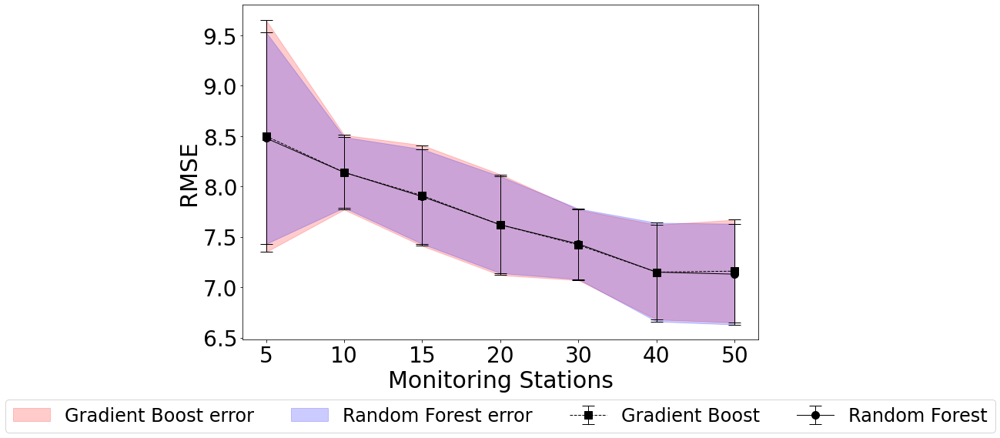

In [166]:
####################################### RMSE ==> No transfer V transfer #######################################

df_no_tf_rmse = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                   'Gradient Boost': [8.5, 8.14, 7.91, 7.62, 7.42, 7.15, 7.16],
                   'Random Forest': [8.48, 8.14, 7.90, 7.62, 7.43, 7.15, 7.13], 
                   'AdaBoost': [8.52, 8.45, 8.43, 8.64, 8.55, 8.34, 8.33],
                   'Support Vector Regression': [8.85, 9.43, 9.20, 8.91, 8.48, 8.38, 8.31],
                   'Stochastic Gradient Descent': [8.75, 8.49, 8.56, 8.58, 8.48, 8.46, 8.32]})

gbr_err = np.array([1.15, 0.37, 0.5, 0.5, 0.35, 0.47, 0.51])
rf_err = np.array([1.05, 0.35, 0.47, 0.48, 0.35, 0.49, 0.5])
adaboost_err = np.array([0.56, 0.15, 0.28, 0.37, 0.38, 0.16, 0.20])
svr_err = np.array([0.68, 1.35, 0.79, 0.92, 0.62, 0.45, 0.4])
sgd_err = np.array([0.54, 0.39, 0.3, 0.43, 0.65, 0.32, .39])

gbr_err_min = np.abs(df_no_tf_rmse['Gradient Boost'].to_numpy() - gbr_err)
gbr_err_max = np.abs(df_no_tf_rmse['Gradient Boost'].to_numpy() + gbr_err)

rf_err_min = np.abs(df_no_tf_rmse['Random Forest'].to_numpy() - rf_err)
rf_err_max = np.abs(df_no_tf_rmse['Random Forest'].to_numpy() + rf_err)


fig = plt.figure(figsize = (12, 8))

plt.errorbar('Monitors', 'Gradient Boost', yerr=gbr_err, data=df_no_tf_rmse, marker='s', capsize=8,
             color='black', markersize=10, linewidth=1, linestyle='--')
plt.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_rmse,
             marker='o', capsize=8, color='black', markersize=10, linewidth=1, linestyle='-')

plt.fill_between(df_no_tf_rmse['Monitors'], gbr_err_min, gbr_err_max, color='red', alpha=0.2, label='Gradient Boost error')
plt.fill_between(df_no_tf_rmse['Monitors'], rf_err_min, rf_err_max, color='blue', alpha=0.2, label='Random Forest error')

plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4, prop={'size': 24})
plt.xlabel("Monitoring Stations", fontsize=30)
plt.xticks(fontsize=28)
plt.ylabel("RMSE", fontsize=30)
plt.yticks(fontsize=28)
# plt.ylim(0, 0.5)
# plt.xlim(-0.2, 3.2)
plt.show()

In [398]:
####################################### R2 score ==> No transfer learning #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                            'Random Forest': [0.03, 0.10, 0.14, 0.22, 0.25, 0.34, 0.35], 
                   'NNW': [0.14, 0.23, 0.25, 0.28, 0.34, 0.37, 0.38],
                    'NNW East': [0.14, 0.25, 0.27, 0.30, 0.35, 0.38, 0.39]})


rf_err = np.array([0.20, 0.17, 0.22, 0.12, 0.12, 0.07, 0.10])
nnw_err = np.array([0.09, 0.06, 0.06, 0.08, 0.08, 0.05, 0.04])
nnw_east_err = np.array([0.11, 0.04, 0.05, 0.07, 0.06, 0.04, 0.04])
kriging_r2 = np.array([0.07, 0.11, 0.13, 0.15, 0.17, 0.19, 0.21])


rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err


fig = plt.figure(figsize = (12, 8))

plt.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='black', markersize=10, linewidth=1, linestyle='-')
plt.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='black', markersize=10, linewidth=1, linestyle='--')
plt.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='black',  markersize=10, linewidth=1, linestyle='--')
plt.plot(kriging_r2, color='blue', marker='o', markersize=10, linewidth=1, linestyle='--', label = 'Kriging')
plt.axvline(x = 3, color = 'red', label = 'transfer threshold', linewidth=3, linestyle='--')

# plt.errorbar('Monitors', 'RULSIF', yerr = rulsif_err, data=df_no_tf_r2, marker='s', capsize=8,
#              color='black', markersize=10, linewidth=1, linestyle='--')
# plt.errorbar('Monitors', 'KMM', yerr = kmm_err, data=df_no_tf_r2, marker='s', capsize=8,
#              color='black', markersize=10, linewidth=1, linestyle='--')


plt.fill_between(df_no_tf_r2['Monitors'], rf_err_min, rf_err_max, color='blue', alpha=0.2, label='Random Forest error')
plt.fill_between(df_no_tf_r2['Monitors'], nnw_err_min, nnw_err_max, color='red', alpha=0.2, label='NNW error')
plt.fill_between(df_no_tf_r2['Monitors'], nnw_east_err_min, nnw_east_err_max, color='green', alpha=0.2, label='NNW East error')
# plt.fill_between(df_no_tf_r2['Monitors'], rulsif_err_min, rulsif_err_max, color='green', alpha=0.2, label='RULSIF error')
# plt.fill_between(df_no_tf_r2['Monitors'], kmm_err_min, kmm_err_max, color='yellow', alpha=0.2, label='KMM error')

plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4, prop={'size': 22})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=22)
plt.ylabel("R2 Score", fontsize=26)
plt.yticks(fontsize=22)
# plt.ylim(, 0.6)
# plt.xlim(-0.2, 3.2)
plt.show()

In [415]:
####################################### R2 score ==> No transfer learning #######################################
from matplotlib.transforms import Affine2D

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                            'Random Forest': [0.03, 0.10, 0.14, 0.22, 0.25, 0.34, 0.35], 
                   'NNW': [0.14, 0.23, 0.25, 0.28, 0.34, 0.37, 0.38],
                    'NNW East': [0.14, 0.25, 0.27, 0.30, 0.35, 0.38, 0.39]})


rf_err = np.array([0.20, 0.17, 0.22, 0.12, 0.12, 0.07, 0.10])
nnw_err = np.array([0.09, 0.06, 0.06, 0.08, 0.08, 0.05, 0.04])
nnw_east_err = np.array([0.11, 0.04, 0.05, 0.07, 0.06, 0.04, 0.04])
kriging_r2 = np.array([0.07, 0.11, 0.13, 0.15, 0.17, 0.19, 0.21])


rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err


# fig = plt.figure(figsize = (12, 8))
fig, ax = plt.subplots(figsize = (12, 8))

trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.1, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.3, 0.0) + ax.transData
ax.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='blue', markersize=10, ls='none', alpha=0.7, transform=trans1) ##linewidth=1, linestyle='-',
ax.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=10, ls='none', alpha=0.7, transform=trans2) ##linewidth=1, linestyle='--', 
ax.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='green',  markersize=10, ls='none', alpha=0.7, transform=trans3) ##linewidth=1, linestyle='--',
ax.plot(kriging_r2, color='maroon', marker='^', markersize=10, linewidth=2, linestyle='--', label = 'Kriging')
ax.axvline(x = 3, color = 'magenta', label = 'transfer threshold', linewidth=3, linestyle='--')


plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4, prop={'size': 22})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=22)
plt.ylabel("R2 Score", fontsize=26)
plt.yticks(fontsize=22)
# plt.ylim(, 0.6)
# plt.xlim(-0.2, 3.2)
plt.show()

In [10]:
####################################### R2 score ==> No transfer learning [5-20] #######################################
from matplotlib.transforms import Affine2D

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                            'Random Forest': [0.03, 0.10, 0.14, 0.22], 
                   'NNW': [0.14, 0.23, 0.25, 0.28],
                    'NNW East': [0.14, 0.25, 0.27, 0.30],
                    'Kriging East': [-0.05, 0.10, 0.21, 0.23]})


rf_err = np.array([0.20, 0.17, 0.22, 0.12])
nnw_err = np.array([0.09, 0.06, 0.06, 0.08])
nnw_east_err = np.array([0.11, 0.04, 0.05, 0.07])
# kriging_r2 = np.array([0.07, 0.11, 0.13, 0.15])
kriging_err = np.array([0.20, 0.11, 0.06, 0.05])


rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err

krig_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - kriging_err
krig_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + kriging_err


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.05, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.2, 0.0) + ax.transData
trans4 = Affine2D().translate(+0.35, 0.0) + ax.transData

ax.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='blue', markersize=15, ls='none', alpha=0.9, linewidth=4, transform=trans1) 

ax.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=15, ls='none', alpha=0.9, linewidth=4, transform=trans2) 

ax.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='green',  markersize=15, ls='none', alpha=0.9, linewidth=4, transform=trans3) 

ax.errorbar('Monitors', 'Kriging East', yerr = kriging_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='maroon',  markersize=15, ls='none', alpha=0.9, linewidth=4, transform=trans4) 

# ax.plot(kriging_r2, color='maroon', marker='^', markersize=10, linewidth=2, linestyle='--', label = 'Kriging')



plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=4, prop={'size': 22})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2 Score", fontsize=26)
plt.yticks(fontsize=24)
plt.show()

In [400]:
####################################### RMSE score ==> No transfer learning #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                   'Random Forest': [8.36, 8.07, 7.90, 7.52, 7.38, 6.95, 6.87], 
                   'NNW': [7.84, 7.43, 7.40, 7.21, 6.94, 6.77, 6.69],
                    'NNW East': [7.86, 7.34, 7.31, 7.15, 6.89, 6.75, 6.63]})

rf_err = np.array([0.80, 0.71, 0.87, 0.58, 0.54, 0.46, 0.55])
nnw_err = np.array([0.47, 0.33, 0.41, 0.57, 0.66, 0.44, 0.34])
nnw_east_err = np.array([0.52, 0.28, 0.37, 0.52, 0.54, 0.39, 0.36])
kriging_rmse = np.array([8.19, 8.02, 7.93, 7.83, 7.74, 7.65, 7.57])



rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err


fig = plt.figure(figsize = (12, 8))

plt.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='black', markersize=10, linewidth=1, linestyle='-')
plt.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='black', markersize=10, linewidth=1, linestyle='--')
plt.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='black', markersize=10, linewidth=1, linestyle='--')
plt.plot(kriging_rmse, color='blue', marker='o', markersize=10, linewidth=1, linestyle='--', label = 'Kriging')
plt.axvline(x = 3, color = 'red', label = 'transfer threshold', linewidth=3, linestyle='--')


plt.fill_between(df_no_tf_r2['Monitors'], rf_err_min, rf_err_max, color='blue', alpha=0.2, label='Random Forest error')
plt.fill_between(df_no_tf_r2['Monitors'], nnw_err_min, nnw_err_max, color='red', alpha=0.2, label='NNW error')
plt.fill_between(df_no_tf_r2['Monitors'], nnw_east_err_min, nnw_east_err_max, color='green', alpha=0.2, label='NNW East error')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=22)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=22)
plt.ylim(6, 10)
# plt.xlim(-0.2, 3.2)
plt.show()

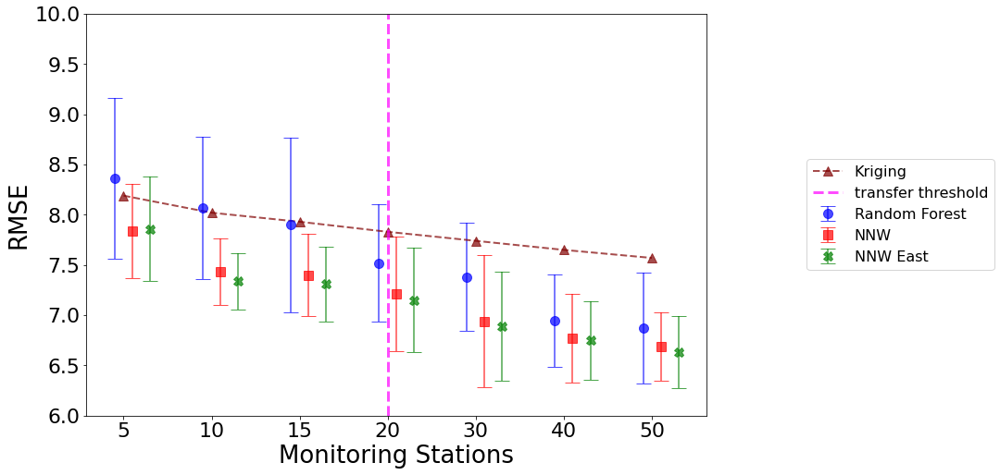

In [421]:
####################################### RMSE score ==> No transfer learning #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20', '30', '40', '50'],
                   'Random Forest': [8.36, 8.07, 7.90, 7.52, 7.38, 6.95, 6.87], 
                   'NNW': [7.84, 7.43, 7.40, 7.21, 6.94, 6.77, 6.69],
                    'NNW East': [7.86, 7.34, 7.31, 7.15, 6.89, 6.75, 6.63]})

rf_err = np.array([0.80, 0.71, 0.87, 0.58, 0.54, 0.46, 0.55])
nnw_err = np.array([0.47, 0.33, 0.41, 0.57, 0.66, 0.44, 0.34])
nnw_east_err = np.array([0.52, 0.28, 0.37, 0.52, 0.54, 0.39, 0.36])
kriging_rmse = np.array([8.19, 8.02, 7.93, 7.83, 7.74, 7.65, 7.57])



rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err


fig, ax = plt.subplots(figsize = (12, 8))

trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.1, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.3, 0.0) + ax.transData

ax.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='blue', markersize=10, ls='none', alpha=0.7, transform = trans1)

ax.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=10, ls='none', alpha=0.7, transform = trans2)

ax.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='green', markersize=10, ls='none', alpha=0.7, transform = trans3)

ax.plot(kriging_rmse, color='maroon', marker='^', markersize=10, linewidth=2, linestyle='--', alpha=0.7, label = 'Kriging')

ax.axvline(x = 3, color = 'magenta', label = 'transfer threshold', linewidth=3, alpha=0.7, linestyle='--')


# plt.fill_between(df_no_tf_r2['Monitors'], rf_err_min, rf_err_max, color='blue', alpha=0.2, label='Random Forest error')
# plt.fill_between(df_no_tf_r2['Monitors'], nnw_err_min, nnw_err_max, color='red', alpha=0.2, label='NNW error')
# plt.fill_between(df_no_tf_r2['Monitors'], nnw_east_err_min, nnw_east_err_max, color='green', alpha=0.2, label='NNW East error')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=22)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=22)
plt.ylim(6, 10)
# plt.xlim(-0.2, 3.2)
plt.show()

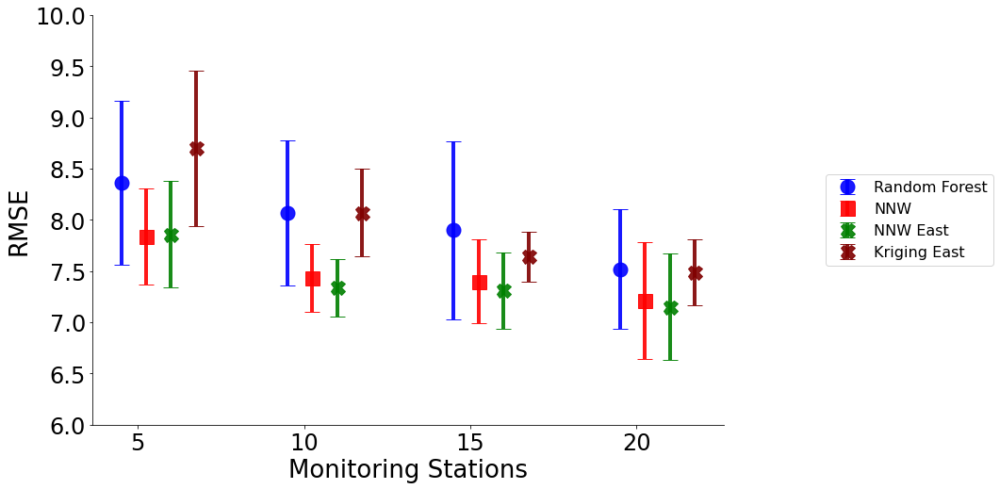

In [29]:
####################################### RMSE score ==> No transfer learning [5-20] #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                   'Random Forest': [8.36, 8.07, 7.90, 7.52], 
                   'NNW': [7.84, 7.43, 7.40, 7.21],
                    'NNW East': [7.86, 7.34, 7.31, 7.15],
                    'Kriging East': [8.70, 8.07, 7.64, 7.49]})

rf_err = np.array([0.80, 0.71, 0.87, 0.58])
nnw_err = np.array([0.47, 0.33, 0.41, 0.57])
nnw_east_err = np.array([0.52, 0.28, 0.37, 0.52])
# kriging_rmse = np.array([8.19, 8.02, 7.93, 7.83])
kriging_err = np.array([0.76, 0.43, 0.24, 0.32])



rf_err_min = df_no_tf_r2['Random Forest'].to_numpy() - rf_err
rf_err_max = df_no_tf_r2['Random Forest'].to_numpy() + rf_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_east_err_min = df_no_tf_r2['NNW East'].to_numpy() - nnw_east_err
nnw_east_err_max = df_no_tf_r2['NNW East'].to_numpy() + nnw_east_err

krig_east_err_min = df_no_tf_r2['Kriging East'].to_numpy() - kriging_err
krig_east_err_max = df_no_tf_r2['Kriging East'].to_numpy() + kriging_err


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.05, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.2, 0.0) + ax.transData
trans4 = Affine2D().translate(+0.35, 0.0) + ax.transData

ax.errorbar('Monitors', 'Random Forest', yerr=rf_err, data=df_no_tf_r2,
             marker='o', capsize=8, color='blue', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans1)

ax.errorbar('Monitors', 'NNW', yerr = nnw_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans2)

ax.errorbar('Monitors', 'NNW East', yerr = nnw_east_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='green', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans3)

ax.errorbar('Monitors', 'Kriging East', yerr = kriging_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='maroon', markersize = 15, ls='none', alpha=0.9, linewidth=4, transform = trans4)

# ax.plot(kriging_rmse, color='maroon', marker='^', markersize=10, linewidth=2, linestyle='--', alpha=0.7, label = 'Kriging')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
plt.ylim(6, 10)
plt.show()

In [ ]:
########################################## Ablation Study ##########################################

In [64]:
####################################### R2 score (East) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                 'rf_ldf': [0.19, 0.28, 0.33, 0.37], 
                 'rf_ldf_coord': [0.18, 0.27, 0.34, 0.38],
                 'nnw_ldf': [0.16, 0.29, 0.35, 0.38],
                 'nnw_ldf_coord': [0.19, 0.32, 0.35, 0.38]})

# rf_ldf = np.array([0.19, 0.28, 0.33, 0.37])
# rf_ldf_coord = np.array([0.18, 0.27, 0.34, 0.38])
# nnw_ldf = np.array([0.16, 0.29, 0.35, 0.38])
# nnw_ldf_coord = np.array([0.19, 0.32, 0.35, 0.38])


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'rf_ldf', data = df, marker='o', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'rf_ldf_coord', data = df, marker='o', color='maroon', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='^', color='blue', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf_coord', data = df, marker='^', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)

# ax.plot(rf_ldf, color='maroon', marker='^', markersize=15, linewidth=3, linestyle='-', alpha=0.9, label = 'RF LDF-whole')
# ax.plot(rf_ldf_coord, color='maroon', marker='^', markersize=15, linewidth=3, linestyle='--', alpha=0.9, label = 'RF LDF-coord')
# ax.plot(nnw_ldf, color='blue', marker='^', markersize=15, linewidth=3, linestyle='-', alpha=0.9, label = 'NNW LDF-whole')
# ax.plot(nnw_ldf_coord, color='blue', marker='^', markersize=15, linewidth=3, linestyle='--', alpha=0.9, label = 'NNW LDF-coord')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2", fontsize=26)
plt.yticks(fontsize=24)
# plt.ylim(6, 10)
plt.title("Eastern US", fontsize=24)
plt.show()

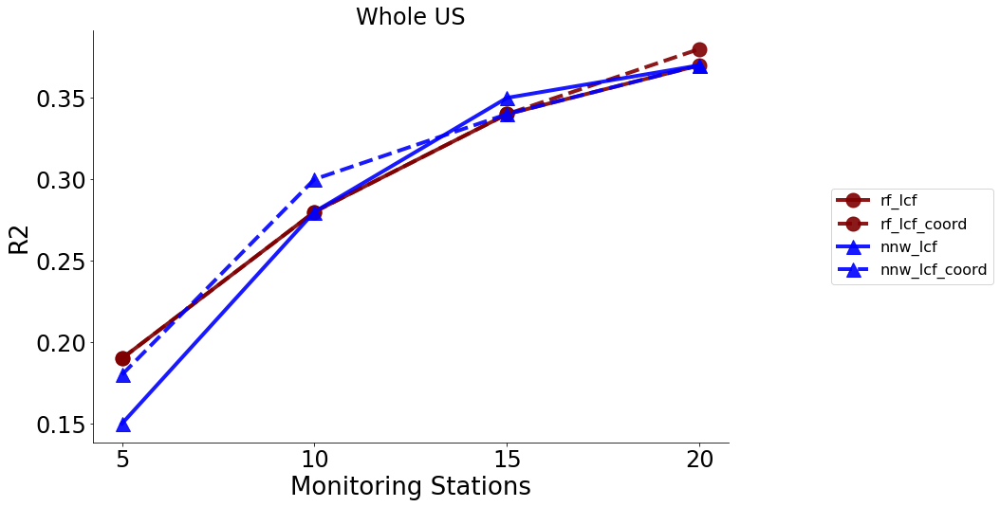

In [63]:
####################################### R2 score (Whole) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                 'rf_ldf': [0.19, 0.28, 0.34, 0.37], 
                 'rf_ldf_coord': [0.19, 0.28, 0.34, 0.38],
                 'nnw_ldf': [0.15, 0.28, 0.35, 0.37],
                 'nnw_ldf_coord': [0.18, 0.30, 0.34, 0.37]})

# rf_ldf = np.array([0.19, 0.28, 0.34, 0.37])
# rf_ldf_coord = np.array([0.19, 0.28, 0.34, 0.38])
# nnw_ldf = np.array([0.15, 0.28, 0.35, 0.37])
# nnw_ldf_coord = np.array([0.18, 0.30, 0.34, 0.37])


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'rf_ldf', data = df, marker='o', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'rf_ldf_coord', data = df, marker='o', color='maroon', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='^', color='blue', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf_coord', data = df, marker='^', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)

# ax.plot(rf_ldf, color='maroon', marker='^', markersize=15, linewidth=3, linestyle='-', alpha=0.9, label = 'RF LDF-whole')
# ax.plot(rf_ldf_coord, color='maroon', marker='^', markersize=15, linewidth=3, linestyle='--', alpha=0.9, label = 'RF LDF-coord')
# ax.plot(nnw_ldf, color='blue', marker='^', markersize=15, linewidth=3, linestyle='-', alpha=0.9, label = 'NNW LDF-whole')
# ax.plot(nnw_ldf_coord, color='blue', marker='^', markersize=15, linewidth=3, linestyle='--', alpha=0.9, label = 'NNW LDF-coord')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2", fontsize=26)
plt.yticks(fontsize=24)
# plt.ylim(6, 10)
plt.title("Whole US", fontsize=24)
plt.show()

In [65]:
####################################### RMSE score (East) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                 'rf_ldf': [7.60, 7.22, 6.97, 6.71], 
                 'rf_ldf_coord': [7.67, 7.24, 6.96, 6.71],
                 'nnw_ldf': [7.77, 7.16, 6.90, 6.73],
                 'nnw_ldf_coord': [7.65, 7.05, 6.90, 6.73]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'rf_ldf', data = df, marker='o', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'rf_ldf_coord', data = df, marker='o', color='maroon', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='^', color='blue', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf_coord', data = df, marker='^', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
# plt.ylim(6, 10)
plt.title("Eastern US", fontsize=24)
plt.show()

In [66]:
####################################### RMSE score (Whole) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '10', '15', '20'],
                 'rf_ldf': [7.61, 7.20, 6.92, 6.76], 
                 'rf_ldf_coord': [7.61, 7.20, 6.92, 6.76],
                 'nnw_ldf': [7.78, 7.18, 6.87, 6.77],
                 'nnw_ldf_coord': [7.66, 7.10, 6.93, 6.77]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'rf_ldf', data = df, marker='o', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'rf_ldf_coord', data = df, marker='o', color='maroon', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='^', color='blue', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf_coord', data = df, marker='^', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
plt.title("Whole US", fontsize=24)
plt.show()

In [ ]:
########################################## New Ablation Study ##########################################

In [21]:
####################################### R2 score (East) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'gbr': [-0.061, 0.064, 0.177, 0.157], 
                   'gbr_ldf': [0.181, 0.305, 0.349, 0.381], 
                   'gbr_ldf_c': [0.160, 0.213, 0.271, 0.300],
                   'nnw': [0.236, 0.263, 0.280, 0.296],
                   'nnw_ldf': [0.247, 0.336, 0.378, 0.378]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'gbr', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf_c', data = df, marker='*', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw', data = df, marker='s', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

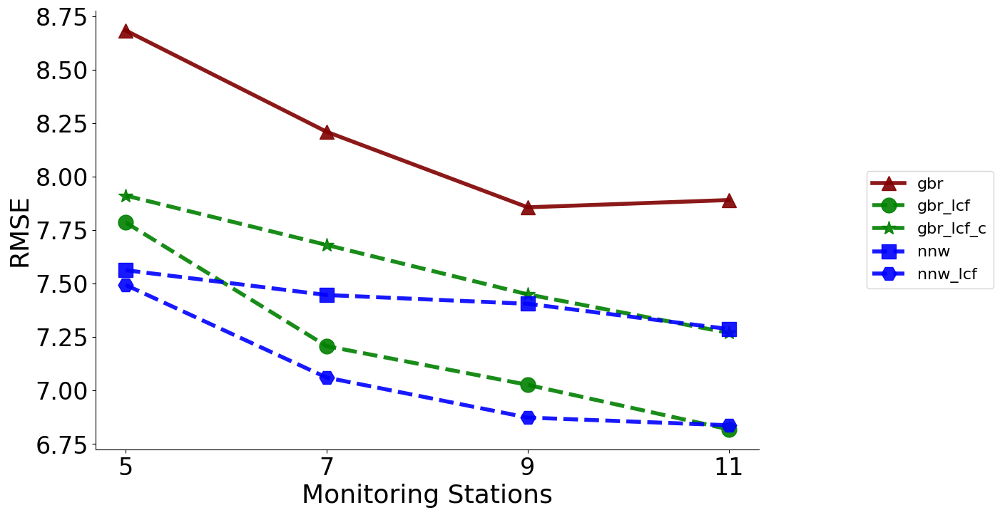

In [7]:
####################################### RMSE score (East) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'gbr': [8.684, 8.210, 7.857, 7.891], 
                   'gbr_ldf': [7.786, 7.208, 7.027, 6.819], 
                   'gbr_ldf_c': [7.912, 7.681, 7.450, 7.270],
                   'nnw': [7.563, 7.447, 7.406, 7.288],
                   'nnw_ldf': [7.494, 7.061, 6.874, 6.838]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'gbr', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf_c', data = df, marker='*', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw', data = df, marker='s', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)

plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

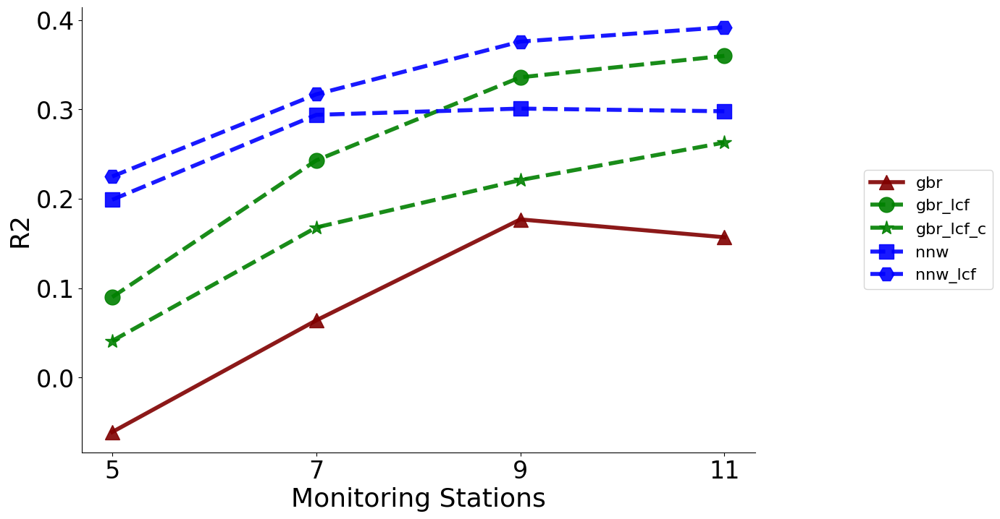

In [31]:
####################################### R2 score (North-East) #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'gbr': [-0.061, 0.064, 0.177, 0.157], 
                   'gbr_ldf': [0.090, 0.243, 0.336, 0.360], 
                   'gbr_ldf_c': [0.041, 0.168, 0.221, 0.263],
                   'nnw': [0.199, 0.294, 0.301, 0.298],
                   'nnw_ldf': [0.225, 0.317, 0.376, 0.392]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'gbr', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf_c', data = df, marker='*', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw', data = df, marker='s', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

In [30]:
####################################### Error Plot RMSE (East) #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'gbr': [8.684, 8.210, 7.857, 7.891], 
                   'gbr_ldf': [7.786, 7.208, 7.027, 6.819], 
                   'gbr_ldf_c': [7.912, 7.681, 7.450, 7.270],
                   'nnw': [7.563, 7.447, 7.406, 7.288],
                   'nnw_ldf': [7.494, 7.061, 6.874, 6.838]
                   })

gbr_err = np.array([1.905, 1.646, 0.920, 1.024])
gbr_ldf_err = np.array([0.750, 0.631, 0.578, 0.505])
gbr_ldf_c_err = np.array([0.592, 0.652, 0.573, 0.475])
nnw_err = np.array([0.441, 0.560, 0.548, 0.495])
nnw_ldf_err = np.array([0.535, 0.490, 0.553, 0.599])



gbr_err_min = df_no_tf_r2['gbr'].to_numpy() - gbr_err
gbr_err_max = df_no_tf_r2['gbr'].to_numpy() + gbr_err

gbr_ldf_err_min = df_no_tf_r2['gbr_ldf'].to_numpy() - gbr_ldf_err
gbr_ldf_err_max = df_no_tf_r2['gbr_ldf'].to_numpy() + gbr_ldf_err

gbr_ldf_c_err_min = df_no_tf_r2['gbr_ldf_c'].to_numpy() - gbr_ldf_c_err
gbr_ldf_c_err_max = df_no_tf_r2['gbr_ldf_c'].to_numpy() + gbr_ldf_c_err

nnw_err_min = df_no_tf_r2['nnw'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['nnw'].to_numpy() + nnw_err

nnw_ldf_err_min = df_no_tf_r2['nnw_ldf'].to_numpy() - nnw_ldf_err
nnw_ldf_err_max = df_no_tf_r2['nnw_ldf'].to_numpy() + nnw_ldf_err


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.05, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.2, 0.0) + ax.transData
trans4 = Affine2D().translate(+0.35, 0.0) + ax.transData
trans5 = Affine2D().translate(+0.50, 0.0) + ax.transData

# trans1 = Affine2D().translate(-0.2, 0.0) + ax.transData
# trans2 = Affine2D().translate(-0.1, 0.0) + ax.transData
# trans3 = Affine2D().translate(+0.1, 0.0) + ax.transData
# trans4 = Affine2D().translate(+0.2, 0.0) + ax.transData
# trans5 = Affine2D().translate(+0.3, 0.0) + ax.transData


ax.errorbar('Monitors', 'gbr', yerr = gbr_err, data = df_no_tf_r2,
             marker='o', capsize=8, color = 'blue', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans1)

ax.errorbar('Monitors', 'gbr_ldf', yerr = gbr_ldf_err, data = df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans2)

ax.errorbar('Monitors', 'gbr_ldf_c', yerr = gbr_ldf_c_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='green', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans3)

ax.errorbar('Monitors', 'nnw', yerr = nnw_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='maroon', markersize = 15, ls = 'none', alpha=0.9, linewidth=4, transform = trans4)

ax.errorbar('Monitors', 'nnw_ldf', yerr = nnw_ldf_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='darkorange', markersize = 15, ls = 'none', alpha=0.9, linewidth=4, transform = trans5)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Sensors", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
plt.ylim(6, 10)
plt.show()

In [38]:
####################################### Error Plot RMSE (North-East) #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'GBR': [8.684, 8.210, 7.857, 7.891], 
                   'GBR-[LDF]': [8.183, 7.510, 7.106, 6.926], 
                   'GBR-[LDF-A]': [8.433, 7.878, 7.695, 7.447],
                   'NNW': [7.732, 7.286, 7.297, 7.257],
                   'NNW-[LDF]': [7.592, 7.157, 6.886, 6.751]
                   })

gbr_err = np.array([1.905, 1.646, 0.920, 1.024])
gbr_ldf_err = np.array([0.963, 0.724, 0.530, 0.557])
gbr_ldf_c_err = np.array([0.759, 0.780, 0.621, 0.519])
nnw_err = np.array([0.546, 0.480, 0.410, 0.525])
nnw_ldf_err = np.array([0.591, 0.544, 0.579, 0.526])



gbr_err_min = df_no_tf_r2['GBR'].to_numpy() - gbr_err
gbr_err_max = df_no_tf_r2['GBR'].to_numpy() + gbr_err

gbr_ldf_err_min = df_no_tf_r2['GBR-[LDF]'].to_numpy() - gbr_ldf_err
gbr_ldf_err_max = df_no_tf_r2['GBR-[LDF]'].to_numpy() + gbr_ldf_err

gbr_ldf_c_err_min = df_no_tf_r2['GBR-[LDF-A]'].to_numpy() - gbr_ldf_c_err
gbr_ldf_c_err_max = df_no_tf_r2['GBR-[LDF-A]'].to_numpy() + gbr_ldf_c_err

nnw_err_min = df_no_tf_r2['NNW'].to_numpy() - nnw_err
nnw_err_max = df_no_tf_r2['NNW'].to_numpy() + nnw_err

nnw_ldf_err_min = df_no_tf_r2['NNW-[LDF]'].to_numpy() - nnw_ldf_err
nnw_ldf_err_max = df_no_tf_r2['NNW-[LDF]'].to_numpy() + nnw_ldf_err


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.05, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.2, 0.0) + ax.transData
trans4 = Affine2D().translate(+0.35, 0.0) + ax.transData
trans5 = Affine2D().translate(+0.50, 0.0) + ax.transData

# trans1 = Affine2D().translate(-0.2, 0.0) + ax.transData
# trans2 = Affine2D().translate(-0.1, 0.0) + ax.transData
# trans3 = Affine2D().translate(+0.1, 0.0) + ax.transData
# trans4 = Affine2D().translate(+0.2, 0.0) + ax.transData
# trans5 = Affine2D().translate(+0.3, 0.0) + ax.transData


ax.errorbar('Monitors', 'GBR', yerr = gbr_err, data = df_no_tf_r2,
             marker='o', capsize=8, color = 'blue', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans1)

ax.errorbar('Monitors', 'GBR-[LDF]', yerr = gbr_ldf_err, data = df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans2)

ax.errorbar('Monitors', 'GBR-[LDF-A]', yerr = gbr_ldf_c_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='green', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans3)

ax.errorbar('Monitors', 'NNW', yerr = nnw_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='maroon', markersize = 15, ls = 'none', alpha=0.9, linewidth=4, transform = trans4)

ax.errorbar('Monitors', 'NNW-[LDF]', yerr = nnw_ldf_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='darkorange', markersize = 15, ls = 'none', alpha=0.9, linewidth=4, transform = trans5)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Sensors", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
plt.ylim(6, 10)
plt.show()

KeyError: 'GBR-[LDF]'

In [4]:
####################################### Optimal Neighbors Number R2 #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   '4': [0.177, 0.276, 0.362, 0.330], 
                   '8': [0.215, 0.318, 0.373, 0.377], 
                   '12': [0.247, 0.336, 0.378, 0.378],
                   '16': [0.211, 0.334, 0.395, 0.393]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', '4', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', '8', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', '12', data = df, marker='*', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', '16', data = df, marker='s', color='darkorange', markersize = 15, ls='--', alpha=0.9, linewidth=4)
# plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Sensors", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("R2", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

/var/folders/19/b_t4kk7x6cs9yr5g7mhxmk1c0000gp/T/ipykernel_38340/2696239871.py:14: RuntimeWarning: Second argument '4' is ambiguous: could be a format string but is in 'data'; using as data.  If it was intended as data, set the format string to an empty string to suppress this warning.  If it was intended as a format string, explicitly pass the x-values as well.  Alternatively, rename the entry in 'data'.
  plt.plot('Monitors', '4', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
/var/folders/19/b_t4kk7x6cs9yr5g7mhxmk1c0000gp/T/ipykernel_38340/2696239871.py:15: RuntimeWarning: Second argument '8' is ambiguous: could be a format string but is in 'data'; using as data.  If it was intended as data, set the format string to an empty string to suppress this warning.  If it was intended as a format string, explicitly pass the x-values as well.  Alternatively, rename the entry in 'data'.
  plt.plot('Monitors', '8', data = df, marker='o', color='green', 

In [5]:
####################################### Optimal Neighbors Number R2 #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   '4': [7.808, 7.317, 6.965, 7.048], 
                   '8': [7.645, 7.153, 6.903, 6.831], 
                   '12': [7.494, 7.061, 6.874, 6.838],
                   '16': [7.657, 7.068, 6.783, 6.746]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', '4', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', '8', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', '12', data = df, marker='*', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', '16', data = df, marker='s', color='darkorange', markersize = 15, ls='--', alpha=0.9, linewidth=4)
# plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Sensors", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

/var/folders/19/b_t4kk7x6cs9yr5g7mhxmk1c0000gp/T/ipykernel_38340/80868678.py:14: RuntimeWarning: Second argument '4' is ambiguous: could be a format string but is in 'data'; using as data.  If it was intended as data, set the format string to an empty string to suppress this warning.  If it was intended as a format string, explicitly pass the x-values as well.  Alternatively, rename the entry in 'data'.
  plt.plot('Monitors', '4', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
/var/folders/19/b_t4kk7x6cs9yr5g7mhxmk1c0000gp/T/ipykernel_38340/80868678.py:15: RuntimeWarning: Second argument '8' is ambiguous: could be a format string but is in 'data'; using as data.  If it was intended as data, set the format string to an empty string to suppress this warning.  If it was intended as a format string, explicitly pass the x-values as well.  Alternatively, rename the entry in 'data'.
  plt.plot('Monitors', '8', data = df, marker='o', color='green', mark

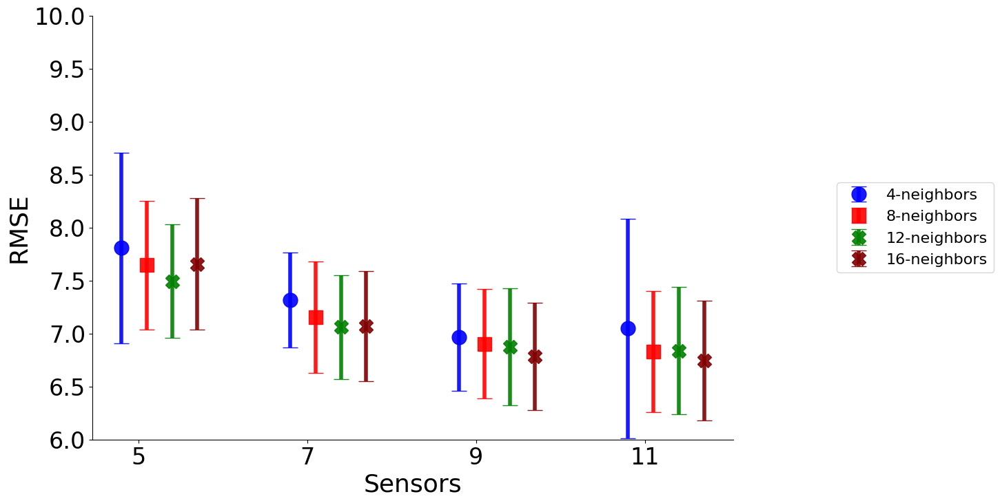

In [16]:
####################################### Optimal Neighbors RMSE score #######################################

df_no_tf_r2 = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   '4-neighbors': [7.808, 7.317, 6.965, 7.048], 
                   '8-neighbors': [7.645, 7.153, 6.903, 6.831],
                    '12-neighbors': [7.494, 7.061, 6.874, 6.838],
                    '16-neighbors': [7.657, 7.068, 6.783, 6.746]})

n_4_err = np.array([0.901, 0.449, 0.505, 1.037])
n_8_err = np.array([0.605, 0.524, 0.517, 0.573])
n_12_err = np.array([0.535, 0.490, 0.553, 0.599])
n_16_err = np.array([0.618, 0.520, 0.508, 0.567])



n_4_err_min = df_no_tf_r2['4-neighbors'].to_numpy() - n_4_err
n_4_err_max = df_no_tf_r2['4-neighbors'].to_numpy() + n_4_err

n_8_err_min = df_no_tf_r2['8-neighbors'].to_numpy() - n_8_err
n_8_err_max = df_no_tf_r2['8-neighbors'].to_numpy() + n_8_err

n_12_err_min = df_no_tf_r2['12-neighbors'].to_numpy() - n_12_err
n_12_err_max = df_no_tf_r2['12-neighbors'].to_numpy() + n_12_err

n_16_err_min = df_no_tf_r2['16-neighbors'].to_numpy() - n_16_err
n_16_err_max = df_no_tf_r2['16-neighbors'].to_numpy() + n_16_err


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


trans1 = Affine2D().translate(-0.1, 0.0) + ax.transData
trans2 = Affine2D().translate(+0.05, 0.0) + ax.transData
trans3 = Affine2D().translate(+0.2, 0.0) + ax.transData
trans4 = Affine2D().translate(+0.35, 0.0) + ax.transData

ax.errorbar('Monitors', '4-neighbors', yerr = n_4_err, data=df_no_tf_r2,
             marker='o', capsize=8, color = 'blue', markersize=15, ls='none', alpha=0.9, linewidth=4, transform = trans1)

ax.errorbar('Monitors', '8-neighbors', yerr = n_8_err, data=df_no_tf_r2, marker='s', capsize=8,
             color='red', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans2)

ax.errorbar('Monitors', '12-neighbors', yerr = n_12_err, data=df_no_tf_r2, marker='X', capsize=8,
             color='green', markersize=15, ls = 'none', alpha=0.9, linewidth=4, transform = trans3)

ax.errorbar('Monitors', '16-neighbors', yerr = n_16_err, data = df_no_tf_r2, marker='X', capsize=8,
             color='maroon', markersize = 15, ls = 'none', alpha=0.9, linewidth=4, transform = trans4)

# ax.plot(kriging_rmse, color='maroon', marker='^', markersize=10, linewidth=2, linestyle='--', alpha=0.7, label = 'Kriging')


plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Sensors", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
plt.ylim(6, 10)
plt.show()

In [ ]:
####################################### RMSE score (North-East) ==> No transfer learning [5-20] #######################################

df = pd.DataFrame({'Monitors': ['5', '7', '9', '11'],
                   'gbr': [8.684, 8.210, 7.857, 7.891], 
                   'gbr_ldf': [8.183, 7.510, 7.106, 6.926], 
                   'gbr_ldf_c': [8.433, 7.878, 7.695, 7.447],
                   'nnw': [7.592, 7.157, 6.886, 6.751],
                   'nnw_ldf': [7.702, 7.122, 6.873, 6.847]})


fig, ax = plt.subplots(figsize = (12, 8))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.plot('Monitors', 'gbr', data = df, marker='^', color='maroon', markersize = 15, ls='-', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf', data = df, marker='o', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'gbr_ldf_c', data = df, marker='*', color='green', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw', data = df, marker='s', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)
plt.plot('Monitors', 'nnw_ldf', data = df, marker='H', color='blue', markersize = 15, ls='--', alpha=0.9, linewidth=4)

plt.legend(loc='center left', bbox_to_anchor=(1.15, 0.5), prop={'size': 16})
plt.xlabel("Monitoring Stations", fontsize=26)
plt.xticks(fontsize=24)
plt.ylabel("RMSE", fontsize=26)
plt.yticks(fontsize=24)
# plt.title("Eastern US", fontsize=24)
plt.show()

In [ ]:
########################################### Train-test split V Monitoring station split ###########################################

In [145]:
# source_cmaq = np.load("/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/source_cmaq.npy").tolist()
# source_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(source_cmaq)]
# source_df = source_df.reset_index()
# source_unique_df = source_df.drop_duplicates('cmaq_id')
# source_unique_df = source_unique_df.reset_index()
# source_unique_df['domain'] = pd.Series(['Source'] * len(source_unique_df))


cmaq_ids = np.load(f"/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/tl-cal-50/split-1/target_cmaq.npz")

target_cmaq = cmaq_ids["train"].tolist()
target_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(target_cmaq)]
target_df = target_df.reset_index()
target_unique_df = target_df.drop_duplicates('cmaq_id')
target_unique_df = target_unique_df.reset_index()
target_unique_df['domain'] = pd.Series(['Target'] * len(target_unique_df))


test_cmaq = cmaq_ids["test"]
test_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(test_cmaq)]
test_df = test_df.reset_index()
test_unique_df = test_df.drop_duplicates('cmaq_id')
test_unique_df = test_unique_df.reset_index()
test_unique_df['domain'] = pd.Series(['Test'] * len(test_unique_df))

# all_domain = result = pd.concat([source_unique_df, target_unique_df, test_unique_df], ignore_index=True)
# all_domain = all_domain.drop(['level_0', 'index'], axis=1)
# all_domain

target_df.shape, test_df.shape 

((9677, 79), (17631, 79))

In [146]:
tag_names = ['day', 'month', 'cmaq_x', 'cmaq_y', 'cmaq_id', 'rid', 'lat', 'lon', 'elev', 'forest_cover', 'pd', 'local', 'limi', 'high', 'is',
    'nldas_pevapsfc','nldas_pressfc', 'nldas_cape', 'nldas_ugrd10m', 'nldas_vgrd10m', 'nldas_tmp2m', 'nldas_rh2m', 'nldas_dlwrfsfc',
    'nldas_dswrfsfc', 'nldas_pcpsfc', 'nldas_fpcsfc', 'gc_aod', 'aod_value', 'emissi11_pm25', 'pm25_value']

In [147]:
monitoring_data = pd.read_csv("US_data/BigUS/us_monitoring.csv")[tag_names]
monitoring_data.shape

(249129, 30)

In [148]:
cal_df = monitoring_data[monitoring_data['rid'] == 6]
cal_df = cal_df.reset_index(drop = True)
cal_df

,day,month,cmaq_x,cmaq_y,cmaq_id,rid,lat,lon,elev,forest_cover,...,nldas_tmp2m,nldas_rh2m,nldas_dlwrfsfc,nldas_dswrfsfc,nldas_pcpsfc,nldas_fpcsfc,gc_aod,aod_value,emissi11_pm25,pm25_value
0,1,1.0,-1950633.194,1.282630e+06,54684,6,32.5,-117.33334,12.8137,0.000000,...,285.089,48.0380,267.967,409.465,0.0,0.0,0.010737,0.051,0.0000,14.200
1,1,1.0,-1938560.545,1.330787e+06,56461,6,33.0,-117.33334,202.0310,0.000000,...,283.767,46.9682,258.316,369.494,0.0,0.0,0.007203,NaN,0.0000,69.850
2,1,1.0,-1938496.481,1.354885e+06,57349,6,33.5,-117.33334,297.8150,0.689624,...,283.924,50.5019,258.899,366.484,0.0,0.0,0.003947,NaN,0.0000,7.700
3,1,1.0,-1950323.911,1.403110e+06,59124,6,33.5,-117.33334,472.9670,0.432507,...,280.131,47.2153,243.597,355.407,0.0,0.0,0.003947,NaN,0.0000,7.300
4,1,1.0,-2022033.538,1.427128e+06,60006,6,34.0,-118.00000,11.4062,0.000000,...,285.574,51.8162,274.311,370.075,0.0,0.0,0.009053,NaN,0.2428,22.775
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27786,365,12.0,-2223912.932,2.081050e+06,83965,6,39.0,-122.00000,220.5070,0.320478,...,283.499,59.5339,263.777,266.895,0.0,0.0,0.002850,0.006,0.0000,8.700
27787,365,12.0,-2163933.420,2.081376e+06,83970,6,39.0,-121.33334,19.4007,0.000000,...,284.403,67.1406,270.603,272.187,0.0,0.0,0.002217,0.045,0.0000,19.000
27788,365,12.0,-2007987.712,2.082094e+06,83983,6,39.5,-120.00000,1378.7600,0.011938,...,274.799,70.7591,214.919,269.860,0.0,0.0,0.002507,0.018,0.0000,5.700
27789,365,12.0,-2187623.382,2.214881e+06,88852,6,40.0,-122.00000,106.4680,0.206774,...,281.307,65.6863,263.789,262.187,0.0,0.0,0.000777,NaN,0.0000,10.100


In [149]:
cal_df_y = cal_df["pm25_value"]
cal_df_x = cal_df.drop(columns=["pm25_value"])

In [151]:
from sklearn.model_selection import train_test_split

train_x, test_x, train_y, test_y = train_test_split(cal_df_x, cal_df_y, test_size=0.65, random_state=42)
train_x = np.nan_to_num(train_x)
test_x = np.nan_to_num(test_x)

train_x.shape, test_x.shape

((9726, 29), (18065, 29))

In [152]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error, r2_score


# Define the hyperparameter space for tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 3, 5],
    'max_features': ['sqrt', 'log2']
}

model_rf = RandomForestRegressor(n_estimators=100, max_depth= None, min_samples_split= 2, min_samples_leaf= 1)
model_rf.fit(train_x, train_y)

pred_rf = model_rf.predict(test_x)

r2_correlation_rf = pearsonr(test_y, pred_rf)
r2_corr_rf = (r2_correlation_rf[0])**2

r2_rf = r2_score(test_y, pred_rf)
rmse_rf = sqrt(mean_squared_error(test_y, pred_rf))
mae_rf = mean_absolute_error(test_y, pred_rf)

In [153]:
r2_corr_rf, r2_rf, rmse_rf, mae_rf

(0.7019851487968843, 0.7000867009651557, 4.613754090223938, 2.877810153282258)

In [ ]:
########################################### East coast source data ###########################################

In [155]:
tag_names = ['day', 'month', 'cmaq_x', 'cmaq_y', 'cmaq_id', 'rid', 'lat', 'lon', 'elev', 'forest_cover', 'pd', 'local', 'limi', 'high', 'is',
    'nldas_pevapsfc','nldas_pressfc', 'nldas_cape', 'nldas_ugrd10m', 'nldas_vgrd10m', 'nldas_tmp2m', 'nldas_rh2m', 'nldas_dlwrfsfc',
    'nldas_dswrfsfc', 'nldas_pcpsfc', 'nldas_fpcsfc', 'gc_aod', 'aod_value', 'emissi11_pm25', 'pm25_value']

In [156]:
monitoring_data = pd.read_csv("US_data/BigUS/us_monitoring.csv")[tag_names]
monitoring_data.shape

(249129, 30)

In [159]:
east_df = monitoring_data[monitoring_data['cmaq_x'] > 0.0]
east_df = east_df.reset_index(drop = True)
east_df.shape

(142822, 30)

In [165]:
east_source_cmaq = east_df['cmaq_id'].unique()
whole_source_cmaq = monitoring_data['cmaq_id'].unique()
len(east_source_cmaq), len(whole_source_cmaq)

(607, 1081)

<Axes: >

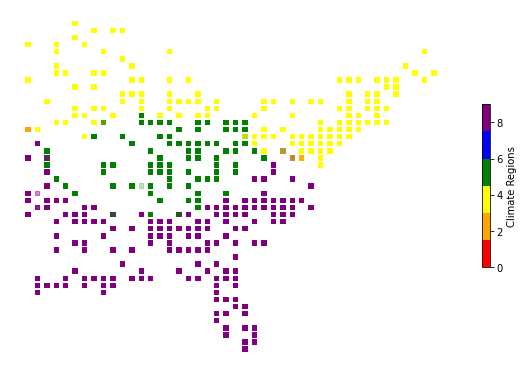

In [162]:
from matplotlib.colors import ListedColormap
from matplotlib import cm
import geopandas as gpd

rid_df = east_df[['lon', 'lat', 'rid']].copy()
rid_df = rid_df.reset_index(drop = True)

fig, ax1 = plt.subplots(figsize = (10, 10))

ax1.axis('off')


rainbow_colors = ListedColormap(['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']) #Using VIBGYOR for colors
color_range = ListedColormap(["red", "orange", "yellow", "green", "blue", "purple", "pink", "brown", "gray", "black"])
color_range2 = ListedColormap(["red", "orange", "yellow", "green", "blue", "purple"])
color_list = ListedColormap(['maroon', 'magenta', '#00abff'])

rid_map = gpd.GeoDataFrame(rid_df, geometry = gpd.points_from_xy(rid_df.lon, rid_df.lat)) 
rid_map.plot(column = 'rid', ax = ax1, cmap = color_range2, 
             alpha=0.25, 
             legend = True, legend_kwds = {'label': "Climate Regions", 'shrink': 0.3},
             marker = "s",
             markersize = 20)


In [ ]:
########################################### Map plot for the entire data ###########################################

In [199]:
tag_names = ['day', 'month', 'cmaq_x', 'cmaq_y', 'cmaq_id', 'rid', 'lat', 'lon', 'elev', 'forest_cover', 'pd', 'local', 'limi', 'high', 'is',
    'nldas_pevapsfc','nldas_pressfc', 'nldas_cape', 'nldas_ugrd10m', 'nldas_vgrd10m', 'nldas_tmp2m', 'nldas_rh2m', 'nldas_dlwrfsfc',
    'nldas_dswrfsfc', 'nldas_pcpsfc', 'nldas_fpcsfc', 'gc_aod', 'aod_value', 'emissi11_pm25', 'pm25_value']

In [200]:
monitoring_data = pd.read_csv("US_data/BigUS/us_monitoring.csv")[tag_names]
monitoring_data.shape

(249129, 30)

In [201]:
monitoring_unique_df = monitoring_data.drop_duplicates('cmaq_id')
monitoring_unique_df = monitoring_unique_df.reset_index(drop = True)
monitoring_unique_df

,day,month,cmaq_x,cmaq_y,cmaq_id,rid,lat,lon,elev,forest_cover,...,nldas_tmp2m,nldas_rh2m,nldas_dlwrfsfc,nldas_dswrfsfc,nldas_pcpsfc,nldas_fpcsfc,gc_aod,aod_value,emissi11_pm25,pm25_value
0,1,1.0,-2.256897e+05,3.587932e+05,20641,8,26.5,-98.00000,35.77930,0.000000,...,293.014,46.4560,361.171,363.874,0.000000,0.000000,0.021297,0.112333,0.0,8.6
1,1,1.0,1.571739e+06,3.949590e+05,23012,9,25.5,-80.66666,1.01104,0.000000,...,297.414,73.5162,364.283,567.165,0.000000,0.000000,0.107923,NaN,0.0,7.9
2,1,1.0,-1.291484e+05,4.863733e+05,25533,8,27.5,-97.33334,2.43082,0.000000,...,290.363,59.1854,313.827,482.562,0.000000,0.000000,0.022637,0.027000,0.0,5.9
3,1,1.0,1.430635e+06,4.666680e+05,25664,9,26.5,-82.00000,3.87558,0.000000,...,297.626,63.8325,355.794,540.059,0.000000,0.000000,0.111803,NaN,0.0,5.4
4,1,1.0,1.573342e+06,4.646160e+05,25676,9,26.0,-80.66666,3.35600,0.020202,...,297.703,67.4090,360.210,549.993,0.000000,0.000000,0.100897,NaN,0.0,10.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1076,300,10.0,-7.580717e+05,2.407723e+06,96075,2,44.5,-105.33334,1375.23000,0.175606,...,279.327,24.9832,260.997,323.217,0.000000,0.000000,0.002993,NaN,0.0,6.0
1077,309,11.0,-1.554955e+06,1.524309e+06,63597,7,35.5,-113.33334,1628.55000,0.919192,...,278.297,48.6444,231.020,445.315,0.224171,0.000000,0.012737,NaN,0.0,1.5
1078,314,11.0,-1.962413e+06,1.354858e+06,57347,6,33.5,-117.33334,59.76920,0.706152,...,289.957,65.4325,284.336,441.974,0.000000,0.000000,0.007383,NaN,0.0,7.9
1079,321,11.0,-2.247366e+06,2.602283e+06,103055,1,43.5,-124.00000,6.15269,0.066845,...,283.256,87.8943,324.006,156.864,0.511971,0.794543,0.098937,NaN,0.0,4.5


In [309]:
from matplotlib.colors import ListedColormap
from matplotlib import cm
import geopandas as gpd

rid_df = monitoring_unique_df[['cmaq_x', 'cmaq_y', 'rid']].copy()
rid_df = rid_df.reset_index(drop = True)

fig, axs = plt.subplots(figsize = (15, 15)) 

us_shape = gpd.read_file('US_data/tl_2012_us_state/tl_2012_us_state.shp').to_crs(epsg=3857)

conterminous_us = us_shape[~us_shape['NAME'].isin(['Alaska', 'Hawaii', 'Guam', 'United States Virgin Islands', 'Puerto Rico', 
                                                   'Commonwealth of the Northern Mariana Islands', 'American Samoa'])]


# xlim = ([conterminous_us.total_bounds[0],  conterminous_us.total_bounds[2]])
# ylim = ([conterminous_us.total_bounds[1],  conterminous_us.total_bounds[3]])

rainbow_colors = ListedColormap(['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']) #Using VIBGYOR for colors
color_list = ['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']
rid_map = gpd.GeoDataFrame(rid_df, geometry = gpd.points_from_xy(rid_df.cmaq_x, rid_df.cmaq_y))
rid_map = rid_map.set_crs('epsg:3857')

# conterminous_us.boundary.plot(ax = axs)
rid_map.plot(column = 'rid', ax = axs, cmap = rainbow_colors, 
             alpha = 0.55, 
             legend = True, legend_kwds = {'label': "Climate Regions", 'shrink': 0.3}, 
             markersize = 20)

# axs.set_xlim(xlim)
# axs.set_ylim(ylim)

axs.set_axis_off()
plt.show()

In [427]:
whole_data = pd.read_csv("US_data/BigUS/largeUS_pred.csv")
whole_unique_df = whole_data.drop_duplicates(subset=['cmaq_x', 'cmaq_y'])
whole_unique_df = whole_unique_df.reset_index(drop = True)
whole_unique_df

,year,day,cmaq_x,cmaq_y,elev,emissi11_pm25,forest_cover,high,limi,local,...,narr_vgrd1815mb,narr_tmp30m,narr_pres2m,narr_pres10m,narr_pres30m,aod_value,pm25_value,gc_aod,pm25_value_k,month
0,2011,1,-1.546318e+05,3.231663e+05,10.23680,0.0,0.039216,0.000000,0.000000,831.897438,...,-3.402230,298.071,98985.8,98882.1,98706.3,NaN,NaN,0.042317,7.278867,1.0
1,2011,1,-1.427332e+05,3.230424e+05,4.38882,0.0,0.007346,0.000000,0.000000,1634.444946,...,-3.402230,298.071,98985.8,98882.1,98706.3,NaN,NaN,0.042317,7.111352,1.0
2,2011,1,-1.783152e+05,3.350347e+05,17.82310,0.0,0.106520,1078.597982,0.000000,306.127464,...,0.222773,294.696,101352.0,101249.0,101040.0,NaN,NaN,0.023270,7.721335,1.0
3,2011,1,-1.664153e+05,3.349110e+05,12.61300,0.0,0.047750,0.000000,0.000000,0.000000,...,0.379023,295.571,101419.0,101315.0,101073.0,NaN,NaN,0.042317,7.491351,1.0
4,2011,1,-1.545156e+05,3.347886e+05,8.23616,0.0,0.211230,0.000000,0.000000,1009.069365,...,0.379023,295.571,101419.0,101315.0,101073.0,NaN,NaN,0.042317,7.282235,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53802,2011,1,-1.949187e+06,3.151649e+06,20.80090,0.0,0.038567,0.000000,638.847016,1318.192756,...,1.756630,287.446,101252.0,101149.0,100906.0,NaN,NaN,0.005140,14.281443,1.0
53803,2011,1,-1.937151e+06,3.151584e+06,14.53420,0.0,0.037649,0.000000,0.000000,0.000000,...,1.756630,287.446,101252.0,101149.0,100906.0,NaN,NaN,0.005140,14.270270,1.0
53804,2011,1,-1.925112e+06,3.151519e+06,20.15010,0.0,0.047237,75.654009,0.000000,0.000000,...,1.756630,287.446,101252.0,101149.0,100906.0,NaN,NaN,0.001153,14.258825,1.0
53805,2011,1,-1.913073e+06,3.151452e+06,181.00500,0.0,0.853806,0.000000,0.000000,0.000000,...,1.535270,286.154,97019.2,96915.4,96673.0,NaN,NaN,0.001153,14.247107,1.0


In [5]:
import plotly.express as px

fig = px.scatter_mapbox(monitoring_data, lat = monitoring_data.cmaq_x, lon = monitoring_data.cmaq_y, color = 'pm25_value')
fig.update_layout(hovermode=False)
fig.show()

In [310]:
source_cmaq = np.load("/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/source_cmaq.npy").tolist()
source_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(source_cmaq)]
source_df = source_df.reset_index()
source_unique_df = source_df.drop_duplicates('cmaq_id')
source_unique_df = source_unique_df.reset_index()
source_unique_df['domain'] = pd.Series(['Source'] * len(source_unique_df))


cmaq_ids = np.load(f"/Users/shrey/Downloads/PM25/PM25-dnntransfer/US_data/split-data/single/tl-cal-10/split-5/target_cmaq.npz")

target_cmaq = cmaq_ids["train"].tolist()
target_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(target_cmaq)]
target_df = target_df.reset_index()
target_unique_df = target_df.drop_duplicates('cmaq_id')
target_unique_df = target_unique_df.reset_index()
target_unique_df['domain'] = pd.Series(['Target'] * len(target_unique_df))


test_cmaq = cmaq_ids["test"]
test_df = monitoring_whole_data[monitoring_whole_data['cmaq_id'].isin(test_cmaq)]
test_df = test_df.reset_index()
test_unique_df = test_df.drop_duplicates('cmaq_id')
test_unique_df = test_unique_df.reset_index()
test_unique_df['domain'] = pd.Series(['Test'] * len(test_unique_df))

all_domain = result = pd.concat([source_unique_df, target_unique_df, test_unique_df], ignore_index=True)
all_domain = all_domain.drop(['level_0', 'index'], axis=1)
all_domain

,year,day,cmaq_x,cmaq_y,elev,emissi11_pm25,forest_cover,high,limi,local,...,narr_tmp30m,narr_pres2m,narr_pres10m,narr_pres30m,aod_value,pm25_value,gc_aod,pm25_value_k,month,domain
0,2011,1,-2.256897e+05,3.587932e+05,35.77930,0.0,0.000000,0.000000,0.000000,873.759842,...,294.425,101386.0,101282.0,101040.0,0.112333,8.6,0.021297,8.582339,1.0,Source
1,2011,1,1.571739e+06,3.949590e+05,1.01104,0.0,0.000000,1050.015418,0.000000,807.793896,...,298.217,101552.0,101482.0,101273.0,NaN,7.9,0.107923,7.383566,1.0,Source
2,2011,1,-1.291484e+05,4.863733e+05,2.43082,0.0,0.000000,0.000000,0.000000,1009.915135,...,293.508,101352.0,101282.0,101073.0,0.027000,5.9,0.022637,5.900033,1.0,Source
3,2011,1,1.430635e+06,4.666680e+05,3.87558,0.0,0.000000,0.000000,2030.156665,0.000000,...,295.279,97185.8,97082.1,96839.6,NaN,5.4,0.111803,7.488950,1.0,Source
4,2011,1,1.573342e+06,4.646160e+05,3.35600,0.0,0.020202,0.000000,0.000000,2037.573293,...,296.529,101586.0,101515.0,101273.0,NaN,10.2,0.100897,7.398404,1.0,Source
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1076,2011,99,-2.223913e+06,2.081050e+06,220.50700,0.0,0.320478,0.000000,0.000000,1338.076280,...,289.196,99623.5,99523.6,99290.7,0.026600,5.1,0.021033,5.298931,4.0,Test
1077,2011,215,-2.056726e+06,1.838874e+06,956.06500,0.0,0.999082,0.000000,0.000000,0.000000,...,298.137,98761.7,98631.0,98471.1,0.034500,1.5,0.015773,2.480141,8.0,Test
1078,2011,231,-2.223501e+06,2.287531e+06,799.72600,0.0,0.972452,0.000000,0.000000,0.000000,...,293.990,97871.2,97740.6,97548.0,0.110600,4.5,0.014880,4.559859,8.0,Test
1079,2011,288,-1.890476e+06,1.415257e+06,622.76700,0.0,0.126722,0.000000,0.000000,0.000000,...,294.009,92020.7,91947.8,91699.2,0.078000,19.9,0.033230,18.935146,10.0,Test


<Axes: >

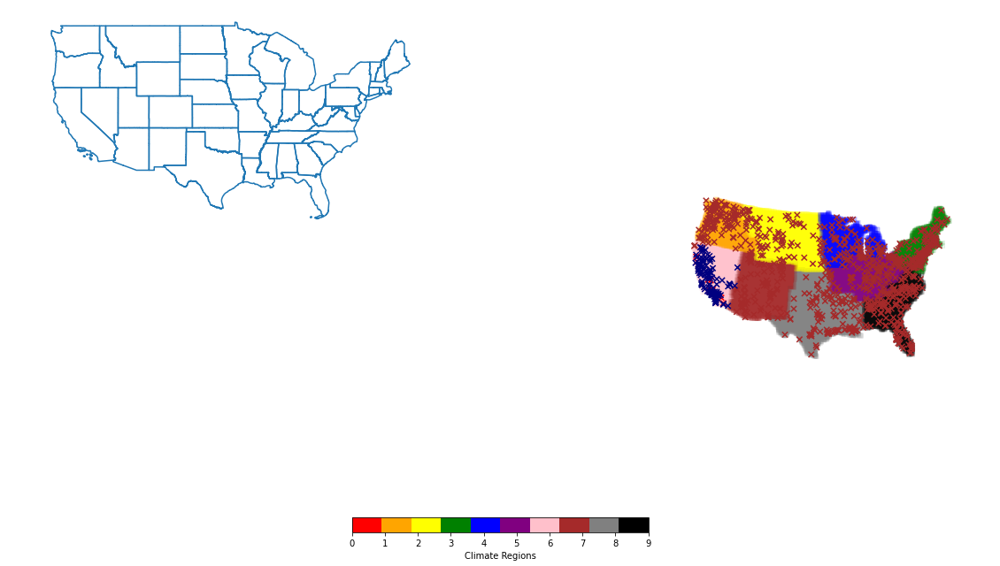

In [346]:
from matplotlib.colors import ListedColormap
from matplotlib import cm
import geopandas as gpd

rid_df = whole_unique_df[['cmaq_x', 'cmaq_y', 'rid']].copy()
rid_df = rid_df.reset_index(drop = True)

us_shape = gpd.read_file('US_data/tl_2012_us_state/tl_2012_us_state.shp').to_crs(epsg=3857)

conterminous_us = us_shape[~us_shape['NAME'].isin(['Alaska', 'Hawaii', 'Guam', 'United States Virgin Islands', 'Puerto Rico', 
                                                   'Commonwealth of the Northern Mariana Islands', 'American Samoa'])]


# shapes = gpd.read_file('US_Data/CONUS_ARD_grid/conus_ard_grid.shp')
fig, ax1 = plt.subplots(figsize = (20, 20))

ax1.axis('off')


rainbow_colors = ListedColormap(['#0000ff', '#0054ff', '#00abff', '#00ffff', '#54ffab', '#abff53', '#ffff00', '#ffaa00', '#ff5400', '#ff0000']) #Using VIBGYOR for colors
color_range = ListedColormap(["red", "orange", "yellow", "green", "blue", "purple", "pink", "brown", "gray", "black"])
color_list = ListedColormap(['brown', 'red', 'navy'])

rid_map = gpd.GeoDataFrame(rid_df, geometry = gpd.points_from_xy(rid_df.cmaq_x, rid_df.cmaq_y)) #Create a geodataframe
rid_map.plot(column = 'rid', ax = ax1, cmap = color_range, 
             alpha = 0.08, 
             legend = True, legend_kwds = {'label': "Climate Regions", 'shrink': 0.3, "orientation": "horizontal"},
             marker = "s",
             markersize = 20)

### legend = True, legend_kwds = {'label': "Domain", 'shrink': 0.3},
data_map = gpd.GeoDataFrame(all_domain, geometry = gpd.points_from_xy(all_domain.cmaq_x, all_domain.cmaq_y)) #Create a geodataframe
data_map.plot(column = 'domain', ax = ax1, cmap = color_list,  
             marker = "x", legend = False,
             markersize = 40)

conterminous_us.boundary.plot(ax = ax1)


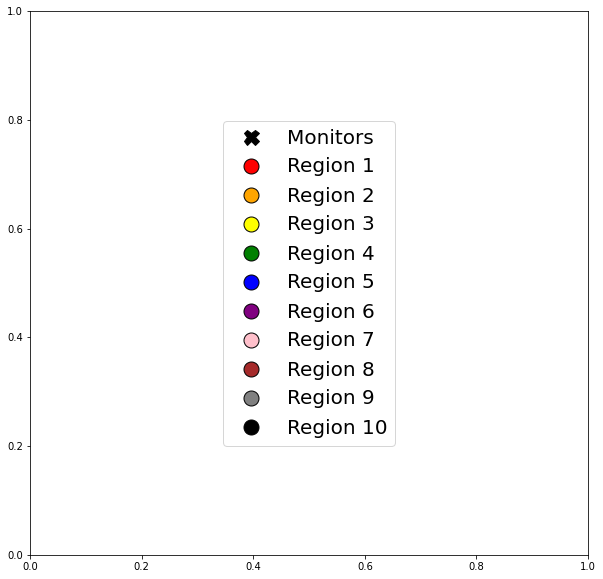

In [344]:
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

legend_elements = [Line2D([0], [0], marker='X', lw=0, color = 'black', markerfacecolor='black', label='Monitors', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='red', label='Region 1', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='orange', label='Region 2', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='yellow', label='Region 3', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='green', label='Region 4', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='blue', label='Region 5', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='purple', label='Region 6', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='pink', label='Region 7', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='brown', label='Region 8', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color = 'black', markerfacecolor='gray', label='Region 9', markersize=15),
                   Line2D([0], [0], marker='o', lw=0, color='black', label='Region 10', markersize=15)]

# Create the figure
fig, ax = plt.subplots(figsize = (10, 10))
ax.legend(handles=legend_elements, loc='center', fontsize="20")

plt.show()

In [297]:
rid_map.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [249]:
us_shape = gpd.read_file('US_data/tl_2012_us_state/tl_2012_us_state.shp')

In [250]:
us_shape.crs

<Projected CRS: PROJCS["WGS_1984_Web_Mercator",GEOGCS["GCS_WGS_198 ...>
Name: Popular Visualisation CRS / Mercator
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [252]:
us_shape['NAME']

0                                           Hawaii
1                                         Arkansas
2                                       New Mexico
3                                          Montana
4                                         New York
5                                     North Dakota
6                                     South Dakota
7                                             Utah
8                                           Oregon
9                                       Washington
10                                  American Samoa
11                                           Idaho
12    Commonwealth of the Northern Mariana Islands
13                                     Puerto Rico
14                                        Oklahoma
15                                      New Jersey
16                                    Rhode Island
17                                       Louisiana
18                                     Connecticut
19                    United St

In [257]:
conterminous_us = us_shape[~us_shape['NAME'].isin(['Alaska', 'Hawaii', 'Guam', 'United States Virgin Islands', 'Puerto Rico', 
                                                   'Commonwealth of the Northern Mariana Islands', 'American Samoa'])]

In [258]:
conterminous_us = conterminous_us.to_crs("EPSG:4326")

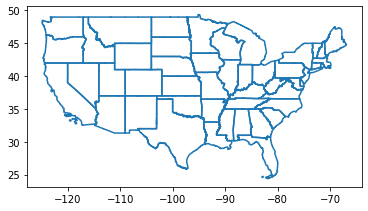

In [259]:
conterminous_us.boundary.plot()
plt.show()

In [277]:
conterminous_us.total_bounds

array([-124.84898942,   24.3963123 ,  -66.88544333,   49.38436644])

In [284]:
import geoplot

ModuleNotFoundError: No module named 'geoplot'